In [3]:
import os
import random

import pyodbc #to connect to sql server 
#ecriture SQL Server
import sqlalchemy
from sqlalchemy.engine import url
from sqlalchemy.engine.url import URL

from pathlib import Path
import pandas as pd
import numpy as np
import nest_asyncio #to avoid runtime issue
nest_asyncio.apply()
import re

#preprocessing
#import nltk
#nltk.download('stopwords')
#from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer
#from nltk.stem import SnowballStemmer
#from nltk.util import ngrams
#from nltk.tokenize import word_tokenize
#nltk.download('punkt') #contents a pre-trained Punkt tokenizer
from emot.emo_unicode import UNICODE_EMOJI # For emojis
from emot.emo_unicode import EMOTICONS_EMO # For EMOTICONS
import emoji
#from deep_translator import GoogleTranslator as GT # translate other languages in french
#from deep_translator import exceptions as excp
#translate foreign languages (other than french)
#! pip install -U deep-translator
import time
from googletrans import Translator
# counting term frequencies
from collections import Counter
# accessing items in table
from operator import itemgetter
# flatten list to string
from nltk.lm.preprocessing import flatten
# create trigram (ngram approach)
from nltk.util import ngrams

#visualisation
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline
plt.style.use('ggplot')
import seaborn as sns
sns.set(style='darkgrid')
sns.set(font_scale=1.3)
from unidecode import unidecode
from wordcloud import WordCloud
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from collections import Counter
from PIL import Image
from plotly.offline import plot
import plotly.graph_objects as go
import plotly.express as px


#Normalisation, lemmatisation, POS tagging
os.environ['TF_XLA_FLAGS'] = '--tf_xla_enable_xla_devices' # helps ussing the GPU much more efficiently than simply ignoring the info.
import spacy
from spacy.language import Language
import spacy_udpipe

#Topic modeling
import gensim
import gensim.corpora as corpora
from gensim.models import CoherenceModel# spaCy for preprocessing
from gensim.utils import simple_preprocess
import pyLDAvis.gensim_models
import pyLDAvis
import pyLDAvis.gensim_models
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
from pprint import pprint
from sklearn.decomposition import NMF
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
import pyLDAvis.lda_model

**CONNEXION TO DWH**

# **Data Overview**

In [7]:
df = df.head(2000)

In [8]:
df.head()

,Id,Brand_Id,Customer_Id,Date_Id#Evaluation,Site_Id,surveyType,answer,Comments
0,1801677,1,1287839453841524983,20220922,50,Uberall - Google Review,5.0,"Très professionnel, merci à Alice pour ces mag..."
1,1801673,1,1287839453841524983,20220922,20,Uberall - Google Review,5.0,Je voulais remercier Mme Dominique pour son pr...
2,1801672,1,1287839453841524983,20220922,11576,Uberall - Google Review,5.0,Antonin c'est occupé de nous de l commande à l...
3,1801674,1,1287839453841524983,20220922,105,Uberall - Google Review,5.0,Bonjour\nJ’ ai été reçue par Léa qui s’est for...
4,1801671,1,1287839453841524983,20220922,5192,Uberall - Google Review,5.0,Très bien guidé par Aurélie pour ma première p...


In [9]:
df.shape

(2000, 8)

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Id                  2000 non-null   int64 
 1   Brand_Id            2000 non-null   int64 
 2   Customer_Id         2000 non-null   int64 
 3   Date_Id#Evaluation  2000 non-null   int64 
 4   Site_Id             2000 non-null   int64 
 5   surveyType          2000 non-null   object
 6   answer              2000 non-null   object
 7   Comments            2000 non-null   object
dtypes: int64(5), object(3)
memory usage: 125.1+ KB


**Data preprocessing**

In [11]:
#convert comments into str and answers into float
df['Comments'] = df['Comments'].astype(str)
df['answer'] = df['answer'].astype(float)

In [12]:
#create word list by splitting every comments by word
liste_mots = [re.split('\W+',doc) for doc in df['Comments']]

In [13]:
#create a new feature to account the number of words of each comment
df['comments_length'] = [len(doc) for doc in liste_mots]

In [14]:
df.head()

,Id,Brand_Id,Customer_Id,Date_Id#Evaluation,Site_Id,surveyType,answer,Comments,comments_length
0,1801677,1,1287839453841524983,20220922,50,Uberall - Google Review,5.0,"Très professionnel, merci à Alice pour ces mag...",15
1,1801673,1,1287839453841524983,20220922,20,Uberall - Google Review,5.0,Je voulais remercier Mme Dominique pour son pr...,35
2,1801672,1,1287839453841524983,20220922,11576,Uberall - Google Review,5.0,Antonin c'est occupé de nous de l commande à l...,32
3,1801674,1,1287839453841524983,20220922,105,Uberall - Google Review,5.0,Bonjour\nJ’ ai été reçue par Léa qui s’est for...,41
4,1801671,1,1287839453841524983,20220922,5192,Uberall - Google Review,5.0,Très bien guidé par Aurélie pour ma première p...,19


In [15]:
# Here we use a column with categorical data
fig = px.histogram(df, x="comments_length")
fig.update_layout(bargap=0.5)
fig.show()

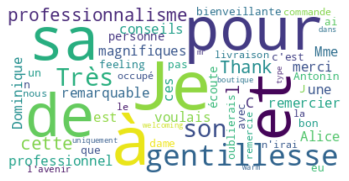

In [16]:
#-------------------most usefull terms in short comments------------------#
text = str(df['Comments'].unique())
wordcloud = WordCloud().generate(text)
stopwords = set(STOPWORDS)
wordcloud = WordCloud(max_font_size=80, max_words=60, background_color="white").generate(text)
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show() 

In [17]:
#transform the comments in list
corpus = list(df['Comments'])
corpus[0:10]

['Très professionnel, merci à Alice pour ces magnifiques conseils et de sa gentillesse remarquable !',
 'Je voulais remercier Mme Dominique pour son professionnalisme, sa gentillesse. C’est une personne à l’écoute et bienveillante. J’ai eu un très bon feeling avec cette dame que je n’oublierais pas !!',
 "Antonin c'est occupé de nous de l commande à la livraison. Je le remercie pour sa gentillesse et son professionnalisme, je n'irai à l'avenir uniquement dans cette boutique.",
 'Bonjour\nJ’ ai été reçue par Léa qui s’est formidablement bien occupée de moi , une remarquable professionnelle qui m’a permis d’avoir des lunettes avec lesquelles j’y vois enfin correctement ; j’ai une myopie très importante …\nEncore merci',
 'Très bien guidé par Aurélie pour ma première paire de lunette. Très agréable et avec de l’humour.',
 'Personne charmante  et serviable extra.',
 "Personnel super sympat à l'écoute et prend le temps de vous conseiller.\nBeaucoup de choix.\nNous sommes répartis très satis

In [18]:
type(corpus)

list

In [19]:
len(corpus)

2000

In [20]:
#count the number of words in every doc within the corpus
i = 1

for doc in corpus:
    print(f"Le document {i} est de longueur : {len(doc)}")
    i+=1

Le document 1 est de longueur : 98
Le document 2 est de longueur : 197
Le document 3 est de longueur : 172
Le document 4 est de longueur : 239
Le document 5 est de longueur : 97
Le document 6 est de longueur : 39
Le document 7 est de longueur : 177
Le document 8 est de longueur : 62
Le document 9 est de longueur : 170
Le document 10 est de longueur : 8
Le document 11 est de longueur : 135
Le document 12 est de longueur : 342
Le document 13 est de longueur : 84
Le document 14 est de longueur : 151
Le document 15 est de longueur : 134
Le document 16 est de longueur : 518
Le document 17 est de longueur : 242
Le document 18 est de longueur : 88
Le document 19 est de longueur : 184
Le document 20 est de longueur : 174
Le document 21 est de longueur : 264
Le document 22 est de longueur : 117
Le document 23 est de longueur : 119
Le document 24 est de longueur : 103
Le document 25 est de longueur : 106
Le document 26 est de longueur : 61
Le document 27 est de longueur : 102
Le document 28 est 

In [21]:
if doc.isdigit() in corpus :
    print(doc)
else : 
    print("Tous les documents sont de type string")

Tous les documents sont de type string


In [22]:
#Tokenization
def test(corpus):
    i = 1

    for doc in corpus:
        #liste_mots= word_tokenize(doc)
        mots = re.split('\W+',doc)
        #comment= re.findall(r"#(\w+)", doc)
        print(f"Le document {i} contient {len(mots)} mots")
        print(f"La liste de mots du document {i} : {mots} \n")
        i+=1
    return mots

#print(comments(corpus))

In [23]:
print(test(corpus))

Le document 1 contient 15 mots
La liste de mots du document 1 : ['Très', 'professionnel', 'merci', 'à', 'Alice', 'pour', 'ces', 'magnifiques', 'conseils', 'et', 'de', 'sa', 'gentillesse', 'remarquable', ''] 

Le document 2 contient 35 mots
La liste de mots du document 2 : ['Je', 'voulais', 'remercier', 'Mme', 'Dominique', 'pour', 'son', 'professionnalisme', 'sa', 'gentillesse', 'C', 'est', 'une', 'personne', 'à', 'l', 'écoute', 'et', 'bienveillante', 'J', 'ai', 'eu', 'un', 'très', 'bon', 'feeling', 'avec', 'cette', 'dame', 'que', 'je', 'n', 'oublierais', 'pas', ''] 

Le document 3 contient 32 mots
La liste de mots du document 3 : ['Antonin', 'c', 'est', 'occupé', 'de', 'nous', 'de', 'l', 'commande', 'à', 'la', 'livraison', 'Je', 'le', 'remercie', 'pour', 'sa', 'gentillesse', 'et', 'son', 'professionnalisme', 'je', 'n', 'irai', 'à', 'l', 'avenir', 'uniquement', 'dans', 'cette', 'boutique', ''] 

Le document 4 contient 41 mots
La liste de mots du document 4 : ['Bonjour', 'J', 'ai', 'été'

#tokenization
def comments(corpus):
    nlp = spacy.load('fr_core_news_md')
    liste_mots = (nlp(str(corpus)))
    return liste_mots



print(comments(corpus))

In [24]:
#from spacy
stopWords = ['a','abord', 'absolument', 'afin', 'ah', 'ai', 'aie', 'ailleurs', 'ainsi', 'ait', 'allaient', 'allo', 'allons',
             'allô', 'alors', 'anterieur', 'anterieure', 'anterieures', 'apres', 'après', 'as', 'assez', 'attendu', 'au',
             'aucun', 'aucune', 'aujourd', "aujourd'hui", 'aupres', 'auquel', 'aura', 'auraient', 'aurait', 'auront', 'aussi',
             'autre', 'autrefois', 'autrement', 'autres', 'autrui', 'aux', 'auxquelles', 'auxquels', 'avaient', 'avais', 'avait',
             'avant', 'avec', 'avoir', 'avons', 'ayant', 'bah', 'bas', 'basee', 'bat', 'beau', 'beaucoup', 'bigre', 'boum',
             'bravo', 'brrr', 'car', 'ce', 'ceci', 'cela', 'celle', 'celle-ci', 'celle-là', 'celles', 'celles-ci', 'celles-là',
             'celui', 'celui-ci', 'celui-là', 'cent', 'cependant', 'certain', 'certaine', 'certaines', 'certains', 'certes', 'ces',
             'cet', 'cette', 'ceux', 'ceux-ci', 'ceux-là', 'chacun', 'chacune', 'chaque', 'cher', 'chers', 'chez', 'chiche', 'chut',
             'chère', 'chères', 'ci', 'cinq', 'cinquantaine', 'cinquante', 'cinquantième', 'cinquième', 'clac', 'clic', 'combien',
             'comme', 'comment', 'comparable', 'comparables', 'compris', 'concernant', 'contre', 'couic', 'crac', "c'", "d'", 'da',
             'dans', 'de', 'debout', 'dedans', 'dehors', 'deja', 'delà', 'depuis', 'dernier', 'derniere', 'derriere', 'derrière',
             'des', 'desormais', 'desquelles', 'desquels', 'dessous', 'dessus', 'deux', 'deuxièmement', 'devant', 'devers',
             'devra', 'different', 'differentes', 'differents', 'différent', 'différente', 'différentes', 'différents', 'dire',
             'directe', 'directement', 'dit', 'dite', 'dits', 'divers', 'diverse', 'diverses', 'dix', 'dix-huit', 'dix-neuf',
             'dix-sept', 'dixième', 'doit', 'doivent', 'donc', 'dont', 'douze', 'douzième', 'dring', 'du', 'duquel', 'durant', 'dès',
             'désormais', "d'", 'effet', 'egale', 'egalement', 'egales', 'eh', 'elle', 'elle-même', 'elles', 'elles-mêmes', 'en',
             'encore', 'enfin', 'entre', 'envers', 'environ', 'es', 'est', 'et', 'etaient', 'etais', 'etait', 'etant', 'etc', 'etre',
             'eu', 'euh', 'eux', 'eux-mêmes', 'exactement', 'excepté', 'extenso', 'exterieur', 'fais', 'faisaient', 'faisant', 'fait',
             'façon', 'feront', 'fi', 'flac', 'floc', 'font', 'gens', 'ha', 'hein', 'hem', 'hep', 'hi', 'ho', 'holà', 'hop', 'hormis',
             'hors', 'hou', 'houp', 'hue', 'hui', 'huit', 'huitième', 'hum', 'hurrah', 'hé', 'hélas', 'i', 'il', 'ils', 'importe',
             'je', 'jusqu', 'jusque', 'juste', "j'","J", "l'","L'", 'la', 'laisser', 'laquelle', 'las', 'le', 'lequel', 'les',
             'lesquelles', 'lesquels', 'leur', 'leurs', 'longtemps', 'lors', 'lorsque', 'lui', 'lui-meme', 'lui-même', 'là', 'lès', "l'",
             "m'", 'ma', 'maint', 'maintenant', 'mais', 'malgre', 'malgré', 'maximale', 'me', 'meme', 'memes', 'mes', 'mien', 'mienne',
             'miennes', 'miens', 'mille', 'mince', 'minimale', 'moi', 'moi-meme', 'moi-même', 'moindres', 'moins', 'mon',
             'moyennant', 'même', 'mêmes', "m'",'na', 'naturel', 'naturelle', 'naturelles', 'neanmoins', 'necessaire',
             'necessairement', 'neuf', 'neuvième', 'ni', 'nombreuses', 'nombreux', 'non', 'nos', 'notamment', 'notre', 'nous', 'nous-mêmes',
             'nouveau', 'nul', 'néanmoins', 'nôtre', 'nôtres', "n'", 'o', 'oh', 'ohé', 'ollé', 'olé', 'on', 'ont', 'onze', 'onzième', 'ore',
             'ou', 'ouf', 'ouias', 'oust', 'ouste', 'outre', 'ouvert', 'ouverte', 'ouverts', 'où', 'paf', 'pan', 'par', 'parce', 'parfois',
             'parle', 'parlent', 'parler', 'parmi', 'parseme', 'partant', 'particulier', 'particulière', 'particulièrement', 'passé',
             'pendant', 'pense', 'permet', 'personne', 'peut', 'peuvent', 'peux', 'pff', 'pfft', 'pfut', 'pif', 'pire', 'plein', 'plouf',
             'plus', 'plusieurs', 'plutôt', 'possessif', 'possessifs', 'possible', 'possibles', 'pouah', 'pour', 'pourquoi', 'pourrais', 'pourrait',
             'pouvait', 'prealable', 'precisement', 'premièrement', 'pres', 'probable', 'probante', 'procedant', 'proche',
             'près', 'psitt', 'pu', 'puis', 'puisque', 'pur', 'pure', "qu'", 'quand', 'quant', 'quant-à-soi', 'quanta', 'quarante', 'quatorze',
             'quatre', 'quatre-vingt', 'quatrième', 'quatrièmement', 'que', 'quel', 'quelconque', 'quelle', 'quelles', "quelqu'un", 'quelque',
             'quelques', 'quels', 'qui', 'quiconque', 'quinze', 'quoi', 'quoique', "qu'", 'rare', 'rarement', 'rares', 'relative', 'relativement',
             'remarquable', 'rend', 'rendre', 'restant', 'reste', 'restent', 'restrictif', 'retour', 'revoici', 'revoilà', 'rien', "s'", 'sa',
             'sacrebleu', 'sait', 'sans', 'sapristi', 'sauf', 'se', 'sein', 'seize', 'selon', 'semblable', 'semblaient', 'semble', 'semblent',
             'sent', 'sept', 'septième', 'sera', 'seraient', 'serait', 'seront', 'ses', 'seul', 'seule', 'seulement', 'si', 'sien', 'sienne',
             'siennes', 'siens', 'sinon', 'six', 'sixième', 'soi', 'soi-même', 'soit', 'soixante', 'son', 'sont', 'sous', 'souvent', 'specifique',
             'specifiques', 'speculatif', 'stop', 'strictement', 'subtiles', 'suffisant', 'suffisante', 'suffit', 'suis', 'suit', 'suivant',
             'suivante', 'suivantes', 'suivants', 'suivre', 'superpose', 'sur', 'surtout', "s'", "t'", 'ta', 'tac', 'tant', 'tardive', 'te',
             'tel', 'telle', 'tellement', 'telles', 'tels', 'tenant', 'tend', 'tenir', 'tente', 'tes', 'tic', 'tien', 'tienne', 'tiennes',
             'tiens', 'toc', 'toi', 'toi-même', 'ton', 'touchant', 'toujours', 'tous', 'tout', 'toute', 'toutefois', 'toutes', 'treize', 'trente',
             'trois', 'troisième', 'troisièmement', 'trop', 'tsoin', 'tsouin', 'tu', 'té', "t'", 'un', 'une', 'unes',
             'uniformement', 'unique', 'uniques', 'uns', 'va', 'vais', 'vas', 'vers', 'via', 'vif', 'vifs', 'vingt', 'vivat', 'vive', 'vives',
             'vlan', 'voici', 'voilà', 'vont', 'vos', 'votre', 'vous', 'vous-mêmes', 'vu', 'vé', 'vôtre', 'vôtres', 'zut', 'à', 'â', 'ça',
             'étaient', 'étais', 'était', 'étant', 'été', 'être', 'ô','a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o',
             'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z', 'grrrrrrr','mdrrrrrr', 'mdr', 'qu','grosso','modo',"c'est","s'est","en gros",'lol'
             ,'ptdr', 'svp','stp','qu', 'tr', 'grand', 'optical',"général d'optique", "fois","vivement","vraiment", "mr.", "vraiment", "lunette", "lunettes"
             , 'mdm', 'm.', 'mme', 'Mme', 'dame', 'ne', "n'", "pas", "lunette"]

stopWords = [unidecode(sw) for sw in stopWords]

In [25]:
#-------------------------Creation of  functions for cleanning process-----------------------#

#remove username et @username
def remove_users(comments):
    comments = re.sub('@[A-Za-z]+[A-Za-z0-9-_]+', '', comments)# remove @ before an alpha numerical word
    # remove tweeted at
    return comments

#remove links
def remove_links(comments):
    comments = re.sub(r'http\S+', '', comments) # remove http links
    comments = re.sub(r'bit.ly/\S+', '', comments) # remove bitly links
    comments = comments.strip('[link]') # remove [links]
    return comments

#lower case
def lower(comments):
    return comments.lower()

#remove stopwords
def removeStopWords(Comments):
    stops=stopWords
    new_comments = ' '.join([word for word in Comments.split() if word not in stops])
    return new_comments

#remove blank space and special caracters
def punct(comments):
    token=RegexpTokenizer(r'\w+')#regex
    comments = token.tokenize(comments)
    comments= " ".join(comments)
    return comments

#remove digits
def remove_digits(comments):
    pattern = r'[^a-zA-zÀ-ú.,!?/:;\"\'\s]'#when ^ inside [] >> don't want to remove these chars
    return re.sub(pattern, '', comments)

#remove spécial characters
def remove_special_characters(comments):
    #define the pattern to keep
    pat = r'[^a-zA-z0-9-zÀ-ú0-9.,!?/:;\"\'\s]'
    return re.sub(pat, '', comments)

def remove_(comments):
    comments = re.sub('([_]+)', ' ',comments)
    return comments

#remove french accent
def accent(comments):
    #Comments = re.sub('[^A-zÀ-ú]+', ' ', Comments) #keep french accents
    comments = unidecode(comments)
    return comments

#transform years
def translate_year(comments):
    comments = re.sub(r'[0-9]{4}', 'annee', comments) 
    return comments

In [26]:
#translate emojis
def translate_emoji(comments) :
    emo = emoji.demojize(comments, language='fr')
    return emo

In [27]:
def translate_comments(comments) :
    time.sleep(0.01)
    translator = Translator()
    #translated = GT(source='auto', target='french').translate(text=comments)
    translated = translator.translate(src='auto', dest='french', text=comments)
    return translated

In [28]:
## apply one part of the functions to the dataframe
df['new_comments'] = df.Comments.apply(func = translate_emoji)
#df['new_comments'] = df.new_comments.apply(func = translate_comments)
df['new_comments'] = df.new_comments.apply(func = translate_year)

In [29]:
sample = "Hello World !"
test = lower(sample)
print(test)

hello world !


In [30]:
df.head()

,Id,Brand_Id,Customer_Id,Date_Id#Evaluation,Site_Id,surveyType,answer,Comments,comments_length,new_comments
0,1801677,1,1287839453841524983,20220922,50,Uberall - Google Review,5.0,"Très professionnel, merci à Alice pour ces mag...",15,"Très professionnel, merci à Alice pour ces mag..."
1,1801673,1,1287839453841524983,20220922,20,Uberall - Google Review,5.0,Je voulais remercier Mme Dominique pour son pr...,35,Je voulais remercier Mme Dominique pour son pr...
2,1801672,1,1287839453841524983,20220922,11576,Uberall - Google Review,5.0,Antonin c'est occupé de nous de l commande à l...,32,Antonin c'est occupé de nous de l commande à l...
3,1801674,1,1287839453841524983,20220922,105,Uberall - Google Review,5.0,Bonjour\nJ’ ai été reçue par Léa qui s’est for...,41,Bonjour\nJ’ ai été reçue par Léa qui s’est for...
4,1801671,1,1287839453841524983,20220922,5192,Uberall - Google Review,5.0,Très bien guidé par Aurélie pour ma première p...,19,Très bien guidé par Aurélie pour ma première p...


**Normalisation**

In [31]:
#Retrieve the comments in a str object
df_str = df['new_comments'].str.split('_', expand=True) #create a df with only df['new_comments] as a column
arr = df_str[0].unique() #retrieve only the comments --output : np.array
my_str = ",".join(str(x) for x in arr) # transform the array into str

In [32]:
len(my_str)

285663

In [33]:
nlp = spacy.load("fr_core_news_md", disable = ["parser"])
#add a language detector
nlp.max_length = len(my_str)
#comments = str(df['new_comments'].unique())
doc = nlp(my_str)

tagged_tokens = [(token.text, token.pos_) for token in doc]

print(tagged_tokens)

[('Très', 'ADV'), ('professionnel', 'ADJ'), (',', 'PUNCT'), ('merci', 'NOUN'), ('à', 'ADP'), ('Alice', 'PROPN'), ('pour', 'ADP'), ('ces', 'DET'), ('magnifiques', 'ADJ'), ('conseils', 'NOUN'), ('et', 'CCONJ'), ('de', 'ADP'), ('sa', 'DET'), ('gentillesse', 'NOUN'), ('remarquable', 'ADJ'), ('!', 'PUNCT'), (',', 'PUNCT'), ('Je', 'PRON'), ('voulais', 'VERB'), ('remercier', 'VERB'), ('Mme', 'NOUN'), ('Dominique', 'PROPN'), ('pour', 'ADP'), ('son', 'DET'), ('professionnalisme', 'NOUN'), (',', 'PUNCT'), ('sa', 'DET'), ('gentillesse', 'NOUN'), ('.', 'PUNCT'), ('C’', 'PRON'), ('est', 'AUX'), ('une', 'DET'), ('personne', 'NOUN'), ('à', 'ADP'), ('l’', 'DET'), ('écoute', 'NOUN'), ('et', 'CCONJ'), ('bienveillante', 'ADJ'), ('.', 'PUNCT'), ('J’', 'PRON'), ('ai', 'AUX'), ('eu', 'VERB'), ('un', 'DET'), ('très', 'ADV'), ('bon', 'ADJ'), ('feeling', 'NOUN'), ('avec', 'ADP'), ('cette', 'DET'), ('dame', 'NOUN'), ('que', 'SCONJ'), ('je', 'PRON'), ('n’', 'ADV'), ('oublierais', 'VERB'), ('pas', 'ADV'), ('!', '

In [34]:
type(my_str)

str

In [35]:
doc = nlp(my_str)
spacy.displacy.render(doc,style='dep',jupyter=True)

/opt/anaconda3/lib/python3.8/site-packages/spacy/displacy/__init__.py:141: UserWarning:

[W005] Doc object not parsed. This means displaCy won't be able to generate a dependency visualization for it. Make sure the Doc was processed with a model that supports dependency parsing, and not just a language class like `English()`. For more info, see the docs:
https://spacy.io/usage/models



In [36]:
nlp = spacy.load("fr_core_news_md")
text = 'top'
doc = nlp(text)
tag_for_top = doc[0].tag_
print(tag_for_top)

X


change the tag of certain words

In [37]:
#load the french language
nlp = spacy.load("fr_core_news_md")

@Language.component("custom_tagging")
#define a custome rule
def custom_tagging(doc): 
    for token in doc:
        if token.text.lower() == 'top':
            token.tag_ = "ADJ"
    return doc

#add the custom compoent to the pipeline 
nlp.add_pipe("custom_tagging")

#process the  text
#text = 'Top'
#docs = nlp(text)


#check the ulpdated tags
#for token in doc:
 #   print(token.text, token.tag_)

<function __main__.custom_tagging(doc)>

#process the  text
text = str(list(df['new_comments'])) #use the original comments
docs = nlp(text)

In [38]:
def lemmatize(docs, allowed_postags = ["NOUN", "ADJ", "VERB", "ADV"]):
  '''
  Performs lemmization of input documents.
  Args:
    - docs: list of strings with input documents
    - allowed_postags: list of accepted Part of Speech (POS) types
  Output:
    - list of strings with lemmatized input
  '''
  nlp = spacy.load("fr_core_news_md")
  nlp.add_pipe("custom_tagging")

  lemmatized_docs = []
  for doc in docs:
    doc = nlp(doc)
    tokens = []
    for token in doc:
      if token.pos_ in allowed_postags:
        tokens.append(token.lemma_)
    lemmatized_docs.append(" ".join(tokens))
  return (lemmatized_docs)

In [39]:
def tokenize(docs):
  '''
  Performs tokenization of input documents.
  Args:
    - docs: list of strings with input documents
  Output:
    - list of strings with tokenized input
  '''
  tokenized_docs = []
  for doc in docs:
    tokens = gensim.utils.simple_preprocess(doc, deacc=True)
    tokenized_docs.append(tokens)
  return (tokenized_docs)

In [40]:
docs = list(df['new_comments']) #use the original comments

In [41]:
print(docs)

['Très professionnel, merci à Alice pour ces magnifiques conseils et de sa gentillesse remarquable !', 'Je voulais remercier Mme Dominique pour son professionnalisme, sa gentillesse. C’est une personne à l’écoute et bienveillante. J’ai eu un très bon feeling avec cette dame que je n’oublierais pas !!', "Antonin c'est occupé de nous de l commande à la livraison. Je le remercie pour sa gentillesse et son professionnalisme, je n'irai à l'avenir uniquement dans cette boutique.", 'Bonjour\nJ’ ai été reçue par Léa qui s’est formidablement bien occupée de moi , une remarquable professionnelle qui m’a permis d’avoir des lunettes avec lesquelles j’y vois enfin correctement ; j’ai une myopie très importante …\nEncore merci', 'Très bien guidé par Aurélie pour ma première paire de lunette. Très agréable et avec de l’humour.', 'Personne charmante  et serviable extra.', "Personnel super sympat à l'écoute et prend le temps de vous conseiller.\nBeaucoup de choix.\nNous sommes répartis très satisfait v

In [42]:
lemmatize(["Top"])

['']

In [43]:
lemmatized_docs = lemmatize(docs)
tokenized_docs = tokenize(lemmatized_docs)

In [44]:
df['lemmatized_docs'] = lemmatized_docs

In [45]:
df.head()

,Id,Brand_Id,Customer_Id,Date_Id#Evaluation,Site_Id,surveyType,answer,Comments,comments_length,new_comments,lemmatized_docs
0,1801677,1,1287839453841524983,20220922,50,Uberall - Google Review,5.0,"Très professionnel, merci à Alice pour ces mag...",15,"Très professionnel, merci à Alice pour ces mag...",très professionnel merci magnifique conseil ge...
1,1801673,1,1287839453841524983,20220922,20,Uberall - Google Review,5.0,Je voulais remercier Mme Dominique pour son pr...,35,Je voulais remercier Mme Dominique pour son pr...,vouloir remercier mme professionnalisme gentil...
2,1801672,1,1287839453841524983,20220922,11576,Uberall - Google Review,5.0,Antonin c'est occupé de nous de l commande à l...,32,Antonin c'est occupé de nous de l commande à l...,occuper commande livraison remercie gentilless...
3,1801674,1,1287839453841524983,20220922,105,Uberall - Google Review,5.0,Bonjour\nJ’ ai été reçue par Léa qui s’est for...,41,Bonjour\nJ’ ai été reçue par Léa qui s’est for...,bonjour j recevoir formidablement bien occuper...
4,1801671,1,1287839453841524983,20220922,5192,Uberall - Google Review,5.0,Très bien guidé par Aurélie pour ma première p...,19,Très bien guidé par Aurélie pour ma première p...,très bien guider premier paire lunette très ag...


In [46]:
df[df['Comments']=='Top']

,Id,Brand_Id,Customer_Id,Date_Id#Evaluation,Site_Id,surveyType,answer,Comments,comments_length,new_comments,lemmatized_docs
389,2037429,1,1287839453841524983,20230703,95,Uberall - Google Review,5.0,Top,1,Top,
516,1872038,1,1287839453841524983,20221210,6,Uberall - Google Review,5.0,Top,1,Top,
1623,1884223,1,1287839453841524983,20221230,15,Uberall - Google Review,5.0,Top,1,Top,


In [47]:
### apply the functions to the dataframe
#df['new_comments'] = df.lemmatized_docs.apply(func = translate_emoji)
#df['new_comments'] = df.new_comments.apply(func = translate_comments)
df['cleaned_comments'] = df.lemmatized_docs.apply(func = accent)
#df['new_comments'] = df.new_comments.apply(func = remove_users)
#df['new_comments'] = df.new_comments.apply(func = remove_links)
df['cleaned_comments'] = df.cleaned_comments.apply(func = lower)
df['cleaned_comments'] = df.cleaned_comments.apply(func = punct)
df['new_comments'] = df.new_comments.apply(func = translate_year)
#df['new_comments'] = df.new_comments.apply(func = remove_digits)
#df['new_comments'] = df.new_comments.apply(func = remove_special_characters)
#df['new_comments'] = df.new_comments.apply(func = remove_)
df['cleaned_comments'] = df.cleaned_comments.apply(func = removeStopWords) #at the end in order to have a better cleaning

In [48]:
#count number of words
word_list = [re.split('\W+',doc) for doc in df['cleaned_comments']]
df['comments_length_2'] = [len(doc) for doc in word_list]

In [49]:
df.head()

,Id,Brand_Id,Customer_Id,Date_Id#Evaluation,Site_Id,surveyType,answer,Comments,comments_length,new_comments,lemmatized_docs,cleaned_comments,comments_length_2
0,1801677,1,1287839453841524983,20220922,50,Uberall - Google Review,5.0,"Très professionnel, merci à Alice pour ces mag...",15,"Très professionnel, merci à Alice pour ces mag...",très professionnel merci magnifique conseil ge...,tres professionnel merci magnifique conseil ge...,6
1,1801673,1,1287839453841524983,20220922,20,Uberall - Google Review,5.0,Je voulais remercier Mme Dominique pour son pr...,35,Je voulais remercier Mme Dominique pour son pr...,vouloir remercier mme professionnalisme gentil...,vouloir remercier professionnalisme gentilless...,10
2,1801672,1,1287839453841524983,20220922,11576,Uberall - Google Review,5.0,Antonin c'est occupé de nous de l commande à l...,32,Antonin c'est occupé de nous de l commande à l...,occuper commande livraison remercie gentilless...,occuper commande livraison remercie gentilless...,10
3,1801674,1,1287839453841524983,20220922,105,Uberall - Google Review,5.0,Bonjour\nJ’ ai été reçue par Léa qui s’est for...,41,Bonjour\nJ’ ai été reçue par Léa qui s’est for...,bonjour j recevoir formidablement bien occuper...,bonjour recevoir formidablement bien occuper p...,13
4,1801671,1,1287839453841524983,20220922,5192,Uberall - Google Review,5.0,Très bien guidé par Aurélie pour ma première p...,19,Très bien guidé par Aurélie pour ma première p...,très bien guider premier paire lunette très ag...,tres bien guider premier paire tres agreable h...,8


In [50]:
# Here we use a column with categorical data
fig = px.histogram(df, x="comments_length_2")
fig.update_layout(bargap=0.2)
fig.show()

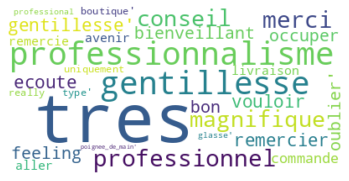

In [51]:
#-------------------most usefull hashtags------------------#
text = str(df['cleaned_comments'].unique())
wordcloud = WordCloud().generate(text)
stopwords = set(STOPWORDS)
wordcloud = WordCloud(max_font_size=80, max_words=60, background_color="white").generate(text)
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show() 

In [52]:
df['Comments'][13]

'Opticien très professionnel , Sophie a été excellente en tous domaines , qualité de service sublime. Les prix et avantages divers sont très attractifs.'

In [53]:
df['lemmatized_docs'][13]

'opticien très professionnel excellent domaine qualité service sublime prix avantage divers très attractif'

In [54]:
df['cleaned_comments'][13]

'opticien tres professionnel excellent domaine qualite service sublime prix avantage tres attractif'

In [55]:
df['comments_length'][13]

23

**Ngram Tokenization**

In [56]:
set_excl_stopwords=set(['ne',"n'",'pas','jamais','non'])

In [57]:
def remove_row_separator(text):
  return text.replace('┇',' ')

def remove_set_excl_stopwords(text):
  text_filtered=[word for word in text.split() if word not in set_excl_stopwords]
  return ' '.join(text_filtered)

https://blog.devgenius.io/working-with-nltk-ngram-analysis-on-airline-sentiment-twitter-dataset-65bf8d568b3c

In [58]:
#create list from ngram generator
# gram1 (unigram) does not include row_separator
df['gram1']=[list(ngrams(remove_row_separator(text).split(),1))for text in df['cleaned_comments']]
df[['gram1']][0:10].style.set_properties(**{'vertical-align': 'top'})

,gram1
0,"[('tres',), ('professionnel',), ('merci',), ('magnifique',), ('conseil',), ('gentillesse',)]"
1,"[('vouloir',), ('remercier',), ('professionnalisme',), ('gentillesse',), ('ecoute',), ('bienveillant',), ('tres',), ('bon',), ('feeling',), ('oublier',)]"
2,"[('occuper',), ('commande',), ('livraison',), ('remercie',), ('gentillesse',), ('professionnalisme',), ('aller',), ('avenir',), ('uniquement',), ('boutique',)]"
3,"[('bonjour',), ('recevoir',), ('formidablement',), ('bien',), ('occuper',), ('professionnel',), ('permettre',), ('voir',), ('correctement',), ('myopie',), ('tres',), ('important',), ('merci',)]"
4,"[('tres',), ('bien',), ('guider',), ('premier',), ('paire',), ('tres',), ('agreable',), ('humour',)]"
5,"[('charmant',), ('serviable',), ('extra',)]"
6,"[('personnel',), ('super',), ('sympat',), ('ecoute',), ('prendre',), ('temps',), ('conseiller',), ('choix',), ('repartir',), ('tres',), ('satisfait',), ('pouvoir',), ('aller',), ('oeil',), ('ferme',)]"
7,"[('accueil',), ('chaleureux',), ('part',), ('ecoute',)]"
8,"[('directeur',), ('adjoint',), ('reparer',), ('sourire',), ('bon',), ('humeur',), ('excellent',), ('accueil',), ('penser',), ('revenir',), ('prochain',), ('monture',), ('optique',), ('solaire',)]"
9,[]


In [59]:
#create list from ngram generator
# gram2 (bigram) does not include row_separator
df['gram2']=[list(ngrams(remove_row_separator(text).split(),2))for text in df['cleaned_comments']]
df[['gram2']][0:10].style.set_properties(**{'vertical-align': 'top'})

,gram2
0,"[('tres', 'professionnel'), ('professionnel', 'merci'), ('merci', 'magnifique'), ('magnifique', 'conseil'), ('conseil', 'gentillesse')]"
1,"[('vouloir', 'remercier'), ('remercier', 'professionnalisme'), ('professionnalisme', 'gentillesse'), ('gentillesse', 'ecoute'), ('ecoute', 'bienveillant'), ('bienveillant', 'tres'), ('tres', 'bon'), ('bon', 'feeling'), ('feeling', 'oublier')]"
2,"[('occuper', 'commande'), ('commande', 'livraison'), ('livraison', 'remercie'), ('remercie', 'gentillesse'), ('gentillesse', 'professionnalisme'), ('professionnalisme', 'aller'), ('aller', 'avenir'), ('avenir', 'uniquement'), ('uniquement', 'boutique')]"
3,"[('bonjour', 'recevoir'), ('recevoir', 'formidablement'), ('formidablement', 'bien'), ('bien', 'occuper'), ('occuper', 'professionnel'), ('professionnel', 'permettre'), ('permettre', 'voir'), ('voir', 'correctement'), ('correctement', 'myopie'), ('myopie', 'tres'), ('tres', 'important'), ('important', 'merci')]"
4,"[('tres', 'bien'), ('bien', 'guider'), ('guider', 'premier'), ('premier', 'paire'), ('paire', 'tres'), ('tres', 'agreable'), ('agreable', 'humour')]"
5,"[('charmant', 'serviable'), ('serviable', 'extra')]"
6,"[('personnel', 'super'), ('super', 'sympat'), ('sympat', 'ecoute'), ('ecoute', 'prendre'), ('prendre', 'temps'), ('temps', 'conseiller'), ('conseiller', 'choix'), ('choix', 'repartir'), ('repartir', 'tres'), ('tres', 'satisfait'), ('satisfait', 'pouvoir'), ('pouvoir', 'aller'), ('aller', 'oeil'), ('oeil', 'ferme')]"
7,"[('accueil', 'chaleureux'), ('chaleureux', 'part'), ('part', 'ecoute')]"
8,"[('directeur', 'adjoint'), ('adjoint', 'reparer'), ('reparer', 'sourire'), ('sourire', 'bon'), ('bon', 'humeur'), ('humeur', 'excellent'), ('excellent', 'accueil'), ('accueil', 'penser'), ('penser', 'revenir'), ('revenir', 'prochain'), ('prochain', 'monture'), ('monture', 'optique'), ('optique', 'solaire')]"
9,[]


In [60]:
#create list from ngram generator
# gram3 (trigram) does not include row_separator
df['gram3']=[list(ngrams(remove_row_separator(text).split(),3))for text in df['cleaned_comments']]
df[['gram3']][0:10].style.set_properties(**{'vertical-align': 'top'})

,gram3
0,"[('tres', 'professionnel', 'merci'), ('professionnel', 'merci', 'magnifique'), ('merci', 'magnifique', 'conseil'), ('magnifique', 'conseil', 'gentillesse')]"
1,"[('vouloir', 'remercier', 'professionnalisme'), ('remercier', 'professionnalisme', 'gentillesse'), ('professionnalisme', 'gentillesse', 'ecoute'), ('gentillesse', 'ecoute', 'bienveillant'), ('ecoute', 'bienveillant', 'tres'), ('bienveillant', 'tres', 'bon'), ('tres', 'bon', 'feeling'), ('bon', 'feeling', 'oublier')]"
2,"[('occuper', 'commande', 'livraison'), ('commande', 'livraison', 'remercie'), ('livraison', 'remercie', 'gentillesse'), ('remercie', 'gentillesse', 'professionnalisme'), ('gentillesse', 'professionnalisme', 'aller'), ('professionnalisme', 'aller', 'avenir'), ('aller', 'avenir', 'uniquement'), ('avenir', 'uniquement', 'boutique')]"
3,"[('bonjour', 'recevoir', 'formidablement'), ('recevoir', 'formidablement', 'bien'), ('formidablement', 'bien', 'occuper'), ('bien', 'occuper', 'professionnel'), ('occuper', 'professionnel', 'permettre'), ('professionnel', 'permettre', 'voir'), ('permettre', 'voir', 'correctement'), ('voir', 'correctement', 'myopie'), ('correctement', 'myopie', 'tres'), ('myopie', 'tres', 'important'), ('tres', 'important', 'merci')]"
4,"[('tres', 'bien', 'guider'), ('bien', 'guider', 'premier'), ('guider', 'premier', 'paire'), ('premier', 'paire', 'tres'), ('paire', 'tres', 'agreable'), ('tres', 'agreable', 'humour')]"
5,"[('charmant', 'serviable', 'extra')]"
6,"[('personnel', 'super', 'sympat'), ('super', 'sympat', 'ecoute'), ('sympat', 'ecoute', 'prendre'), ('ecoute', 'prendre', 'temps'), ('prendre', 'temps', 'conseiller'), ('temps', 'conseiller', 'choix'), ('conseiller', 'choix', 'repartir'), ('choix', 'repartir', 'tres'), ('repartir', 'tres', 'satisfait'), ('tres', 'satisfait', 'pouvoir'), ('satisfait', 'pouvoir', 'aller'), ('pouvoir', 'aller', 'oeil'), ('aller', 'oeil', 'ferme')]"
7,"[('accueil', 'chaleureux', 'part'), ('chaleureux', 'part', 'ecoute')]"
8,"[('directeur', 'adjoint', 'reparer'), ('adjoint', 'reparer', 'sourire'), ('reparer', 'sourire', 'bon'), ('sourire', 'bon', 'humeur'), ('bon', 'humeur', 'excellent'), ('humeur', 'excellent', 'accueil'), ('excellent', 'accueil', 'penser'), ('accueil', 'penser', 'revenir'), ('penser', 'revenir', 'prochain'), ('revenir', 'prochain', 'monture'), ('prochain', 'monture', 'optique'), ('monture', 'optique', 'solaire')]"
9,[]


In [61]:
# count gram1 tokens
count_gram1 = Counter (flatten(list_item for list_item in df['gram1']))
print('len count_gram1:',len(count_gram1))
list_gram1 = sorted(list(count_gram1.items()),key=itemgetter(1),reverse=True)
print('len list_gram1:', len(list_gram1))
#limiting to top 300
print(list_gram1[0:300])

len count_gram1: 2380
len list_gram1: 2380
[(('tres',), 1328), (('merci',), 793), (('accueil',), 584), (('bon',), 563), (('recommander',), 433), (('conseil',), 381), (('service',), 374), (('bien',), 312), (('professionnel',), 284), (('ecoute',), 248), (('conseiller',), 245), (('equipe',), 221), (('choix',), 216), (('magasin',), 208), (('personnel',), 200), (('professionnalisme',), 196), (('agreable',), 191), (('faire',), 190), (('accueillir',), 189), (('monture',), 188), (('client',), 171), (('super',), 153), (('opticien',), 142), (('paire',), 137), (('prendre',), 133), (('recevoir',), 132), (('experience',), 124), (('gentillesse',), 115), (('chaleureux',), 109), (('temps',), 106), (('charge',), 103), (('sympathique',), 101), (('savoir',), 101), (('excellent',), 100), (('rapide',), 99), (('vendeur',), 92), (('efficace',), 91), (('qualite',), 89), (('sourire',), 86), (('aller',), 85), (('parfait',), 82), (('trouver',), 80), (('venir',), 80), (('reparation',), 80), (('revenir',), 74), ((

In [62]:
# count gram2 tokens
count_gram2 = Counter (flatten(list_item for list_item in df['gram2']))
print('len count_gram2:',len(count_gram2))
list_gram2 = sorted(list(count_gram2.items()),key=itemgetter(1),reverse=True)
print('len list_gram2:', len(list_gram2))
#limiting to top 300
print(list_gram2[0:300])

len count_gram2: 11057
len list_gram2: 11057
[(('tres', 'bon'), 323), (('bon', 'conseil'), 184), (('bon', 'accueil'), 150), (('tres', 'bien'), 149), (('tres', 'professionnel'), 133), (('personnel', 'tres'), 90), (('accueil', 'tres'), 84), (('tres', 'agreable'), 81), (('bien', 'accueillir'), 73), (('prise', 'charge'), 69), (('prendre', 'temps'), 67), (('choix', 'monture'), 65), (('tres', 'satisfait'), 54), (('accueil', 'chaleureux'), 54), (('bien', 'recevoir'), 52), (('recommander', 'fortement'), 46), (('merci', 'professionnalisme'), 44), (('tres', 'sympathique'), 43), (('merci', 'accueil'), 42), (('bien', 'conseiller'), 41), (('merci', 'equipe'), 38), (('equipe', 'tres'), 36), (('tres', 'ecoute'), 35), (('recommander', 'magasin'), 34), (('tres', 'accueillir'), 32), (('excellent', 'accueil'), 31), (('accueil', 'conseil'), 31), (('tres', 'gentil'), 31), (('accueil', 'service'), 30), (('professionnel', 'tres'), 30), (('tres', 'sympa'), 29), (('service', 'client'), 28), (('large', 'choix')

In [63]:
# count gram 3 tokens
count_gram3 = Counter (flatten(list_item for list_item in df['gram3']))
print('len count_gram3:',len(count_gram3))
list_gram3 = sorted(list(count_gram3.items()),key=itemgetter(1),reverse=True)
print('len list_gram3:', len(list_gram3))
#limiting to top 300
print(list_gram3[0:300])

len count_gram3: 14242
len list_gram3: 14242
[(('tres', 'bon', 'accueil'), 120), (('tres', 'bon', 'conseil'), 96), (('tres', 'bien', 'accueillir'), 46), (('tres', 'bien', 'recevoir'), 32), (('tres', 'bien', 'conseiller'), 24), (('personnel', 'tres', 'accueillir'), 22), (('tres', 'bon', 'experience'), 21), (('bon', 'accueil', 'tres'), 20), (('bon', 'conseil', 'recommander'), 18), (('accueil', 'tres', 'bon'), 17), (('accueil', 'tres', 'chaleureux'), 16), (('tres', 'professionnel', 'tres'), 15), (('tres', 'bon', 'service'), 15), (('bon', 'accueil', 'personnel'), 15), (('prise', 'charge', 'rapide'), 14), (('accueil', 'tres', 'agreable'), 14), (('bon', 'accueil', 'bon'), 13), (('personnel', 'tres', 'agreable'), 13), (('tres', 'professionnel', 'ecoute'), 12), (('large', 'choix', 'monture'), 12), (('tres', 'professionnel', 'merci'), 11), (('tres', 'professionnel', 'recommander'), 11), (('bon', 'accueil', 'conseil'), 10), (('bon', 'conseil', 'merci'), 10), (('excellent', 'accueil', 'tres'), 10

In [64]:
# create a list for gram1 that occurs more than 1 time
list_gram1_word_gt_1=[gram[0] for gram in list_gram1 if int(gram[1])>1]
print(list_gram1_word_gt_1)

[('tres',), ('merci',), ('accueil',), ('bon',), ('recommander',), ('conseil',), ('service',), ('bien',), ('professionnel',), ('ecoute',), ('conseiller',), ('equipe',), ('choix',), ('magasin',), ('personnel',), ('professionnalisme',), ('agreable',), ('faire',), ('accueillir',), ('monture',), ('client',), ('super',), ('opticien',), ('paire',), ('prendre',), ('recevoir',), ('experience',), ('gentillesse',), ('chaleureux',), ('temps',), ('charge',), ('sympathique',), ('savoir',), ('excellent',), ('rapide',), ('vendeur',), ('efficace',), ('qualite',), ('sourire',), ('aller',), ('parfait',), ('trouver',), ('venir',), ('reparation',), ('revenir',), ('satisfait',), ('prise',), ('souriant',), ('verre',), ('gentil',), ('boutique',), ('remercier',), ('part',), ('reparer',), ('fortement',), ('vue',), ('pouvoir',), ('besoin',), ('accueillant',), ('competent',), ('patient',), ('passer',), ('patience',), ('oeil',), ('sympa',), ('occuper',), ('jour',), ('acheter',), ('bel',), ('probleme',), ('serviabl

In [65]:
# create a list for gram2 that occurs more than 1 time
list_gram2_word_gt_1=[gram[0] for gram in list_gram2 if int(gram[1])>1]
print(list_gram2_word_gt_1)

[('tres', 'bon'), ('bon', 'conseil'), ('bon', 'accueil'), ('tres', 'bien'), ('tres', 'professionnel'), ('personnel', 'tres'), ('accueil', 'tres'), ('tres', 'agreable'), ('bien', 'accueillir'), ('prise', 'charge'), ('prendre', 'temps'), ('choix', 'monture'), ('tres', 'satisfait'), ('accueil', 'chaleureux'), ('bien', 'recevoir'), ('recommander', 'fortement'), ('merci', 'professionnalisme'), ('tres', 'sympathique'), ('merci', 'accueil'), ('bien', 'conseiller'), ('merci', 'equipe'), ('equipe', 'tres'), ('tres', 'ecoute'), ('recommander', 'magasin'), ('tres', 'accueillir'), ('excellent', 'accueil'), ('accueil', 'conseil'), ('tres', 'gentil'), ('accueil', 'service'), ('professionnel', 'tres'), ('tres', 'sympa'), ('service', 'client'), ('large', 'choix'), ('prendre', 'charge'), ('bon', 'service'), ('bon', 'experience'), ('tres', 'bel'), ('conseil', 'recommander'), ('tres', 'accueillant'), ('bon', 'humeur'), ('conseiller', 'tres'), ('accueil', 'professionnalisme'), ('professionnel', 'recommand

In [66]:
# create a list for gram3 that occurs more than 1 time
list_gram3_word_gt_1=[gram[0] for gram in list_gram3 if int(gram[1])>1]
print(list_gram3_word_gt_1)

[('tres', 'bon', 'accueil'), ('tres', 'bon', 'conseil'), ('tres', 'bien', 'accueillir'), ('tres', 'bien', 'recevoir'), ('tres', 'bien', 'conseiller'), ('personnel', 'tres', 'accueillir'), ('tres', 'bon', 'experience'), ('bon', 'accueil', 'tres'), ('bon', 'conseil', 'recommander'), ('accueil', 'tres', 'bon'), ('accueil', 'tres', 'chaleureux'), ('tres', 'professionnel', 'tres'), ('tres', 'bon', 'service'), ('bon', 'accueil', 'personnel'), ('prise', 'charge', 'rapide'), ('accueil', 'tres', 'agreable'), ('bon', 'accueil', 'bon'), ('personnel', 'tres', 'agreable'), ('tres', 'professionnel', 'ecoute'), ('large', 'choix', 'monture'), ('tres', 'professionnel', 'merci'), ('tres', 'professionnel', 'recommander'), ('bon', 'accueil', 'conseil'), ('bon', 'conseil', 'merci'), ('excellent', 'accueil', 'tres'), ('accueil', 'tres', 'professionnel'), ('bon', 'conseil', 'tres'), ('prendre', 'temps', 'expliquer'), ('tres', 'bon', 'conseiller'), ('tres', 'bel', 'accueil'), ('accueil', 'bon', 'conseil'), ('

In [67]:
df.columns

Index(['Id', 'Brand_Id', 'Customer_Id', 'Date_Id#Evaluation', 'Site_Id',
       'surveyType', 'answer', 'Comments', 'comments_length', 'new_comments',
       'lemmatized_docs', 'cleaned_comments', 'comments_length_2', 'gram1',
       'gram2', 'gram3'],
      dtype='object')

In [68]:
# filter gram1 word containing word that occurs more than 1 time only
df['gram1_word_gt_1']=[', '.join('_'.join([gram[0]]) for gram in list_gram if gram in list_gram1_word_gt_1) for list_gram in df['gram1']]

In [69]:
# filter gram2 word containing word that occurs more than 1 time only
df['gram2_word_gt_1']=[', '.join('_'.join([gram[0],gram[1]]) for gram in list_gram if gram in list_gram2_word_gt_1) for list_gram in df['gram2']]

In [70]:
df['gram3_word_gt_1']=[', '.join('_'.join([gram[0],gram[1],gram[2]]) for gram in list_gram if gram in list_gram3_word_gt_1) for list_gram in df['gram3']]

df[['Id', 'Brand_Id', 'Customer_Id', 'Date_Id#Evaluation', 'Site_Id',
       'surveyType', 'answer', 'Comments', 'new_comments', 'lemmatized_docs',
       'cleaned_comments','comments_length', 'gram1','gram1_word_gt_1'
       , 'gram2','gram2_word_gt_1', 'gram3','gram3_word_gt_1'
       ]].head(50) #style.set_properties(**{'vertical-align': 'top'})[10]

In [71]:
df[df['Comments']=='Top']

,Id,Brand_Id,Customer_Id,Date_Id#Evaluation,Site_Id,surveyType,answer,Comments,comments_length,new_comments,lemmatized_docs,cleaned_comments,comments_length_2,gram1,gram2,gram3,gram1_word_gt_1,gram2_word_gt_1,gram3_word_gt_1
389,2037429,1,1287839453841524983,20230703,95,Uberall - Google Review,5.0,Top,1,Top,,,1,[],[],[],,,
516,1872038,1,1287839453841524983,20221210,6,Uberall - Google Review,5.0,Top,1,Top,,,1,[],[],[],,,
1623,1884223,1,1287839453841524983,20221230,15,Uberall - Google Review,5.0,Top,1,Top,,,1,[],[],[],,,


In [72]:
df.head()

,Id,Brand_Id,Customer_Id,Date_Id#Evaluation,Site_Id,surveyType,answer,Comments,comments_length,new_comments,lemmatized_docs,cleaned_comments,comments_length_2,gram1,gram2,gram3,gram1_word_gt_1,gram2_word_gt_1,gram3_word_gt_1
0,1801677,1,1287839453841524983,20220922,50,Uberall - Google Review,5.0,"Très professionnel, merci à Alice pour ces mag...",15,"Très professionnel, merci à Alice pour ces mag...",très professionnel merci magnifique conseil ge...,tres professionnel merci magnifique conseil ge...,6,"[(tres,), (professionnel,), (merci,), (magnifi...","[(tres, professionnel), (professionnel, merci)...","[(tres, professionnel, merci), (professionnel,...","tres, professionnel, merci, magnifique, consei...","tres_professionnel, professionnel_merci, merci...",tres_professionnel_merci
1,1801673,1,1287839453841524983,20220922,20,Uberall - Google Review,5.0,Je voulais remercier Mme Dominique pour son pr...,35,Je voulais remercier Mme Dominique pour son pr...,vouloir remercier mme professionnalisme gentil...,vouloir remercier professionnalisme gentilless...,10,"[(vouloir,), (remercier,), (professionnalisme,...","[(vouloir, remercier), (remercier, professionn...","[(vouloir, remercier, professionnalisme), (rem...","vouloir, remercier, professionnalisme, gentill...","vouloir_remercier, remercier_professionnalisme...",remercier_professionnalisme_gentillesse
2,1801672,1,1287839453841524983,20220922,11576,Uberall - Google Review,5.0,Antonin c'est occupé de nous de l commande à l...,32,Antonin c'est occupé de nous de l commande à l...,occuper commande livraison remercie gentilless...,occuper commande livraison remercie gentilless...,10,"[(occuper,), (commande,), (livraison,), (remer...","[(occuper, commande), (commande, livraison), (...","[(occuper, commande, livraison), (commande, li...","occuper, commande, livraison, remercie, gentil...","occuper_commande, gentillesse_professionnalisme",
3,1801674,1,1287839453841524983,20220922,105,Uberall - Google Review,5.0,Bonjour\nJ’ ai été reçue par Léa qui s’est for...,41,Bonjour\nJ’ ai été reçue par Léa qui s’est for...,bonjour j recevoir formidablement bien occuper...,bonjour recevoir formidablement bien occuper p...,13,"[(bonjour,), (recevoir,), (formidablement,), (...","[(bonjour, recevoir), (recevoir, formidablemen...","[(bonjour, recevoir, formidablement), (recevoi...","bonjour, recevoir, formidablement, bien, occup...","bonjour_recevoir, formidablement_bien, bien_oc...",
4,1801671,1,1287839453841524983,20220922,5192,Uberall - Google Review,5.0,Très bien guidé par Aurélie pour ma première p...,19,Très bien guidé par Aurélie pour ma première p...,très bien guider premier paire lunette très ag...,tres bien guider premier paire tres agreable h...,8,"[(tres,), (bien,), (guider,), (premier,), (pai...","[(tres, bien), (bien, guider), (guider, premie...","[(tres, bien, guider), (bien, guider, premier)...","tres, bien, guider, premier, paire, tres, agre...","tres_bien, bien_guider, premier_paire, paire_t...",tres_bien_guider


**Visualisation**

In [73]:
# Word Frequency
longtext= my_str
nlp = spacy.load("fr_core_news_sm", disable = ["ner"])
long_text=nlp(longtext)


list_of_tokens=[token.text for token in long_text if not token.is_stop and not token.is_punct]
token_frequency=Counter(list_of_tokens)
#print(token_frequency)
#printing 6 most coomon words using most_common() method of Counter

most_frequent_tokens=token_frequency.most_common(10)
print(most_frequent_tokens)

[('\n', 762), ('lunettes', 550), ('accueil', 466), ('recommande', 399), ('bien', 300), (' ', 300), ('bon', 296), ('été', 291), ('service', 276), ('conseils', 260)]


In [74]:
def get_top_n_bigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(1, 1), stop_words=stopWords).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = get_top_n_bigram(df['gram1_word_gt_1'], 10)
df3 = pd.DataFrame(common_words, columns = ['onegram' , 'count'])

fig = go.Figure([go.Bar(x=df3['onegram'], y=df3['count'])])
fig.update_layout(title=go.layout.Title(text="Top 10 one gram in the comments after removing stop words and lemmatization"))
fig.show()

/opt/anaconda3/lib/python3.8/site-packages/sklearn/feature_extraction/text.py:409: UserWarning:

Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['general', 'gros', 'mr', 'optique', 'quelqu'] not in stop_words.



In [75]:
def get_top_n_bigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(2, 2), stop_words=stopWords).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = get_top_n_bigram(df['cleaned_comments'], 20)
df3 = pd.DataFrame(common_words, columns = ['bigram' , 'count'])

fig = go.Figure([go.Bar(x=df3['bigram'], y=df3['count'])])
fig.update_layout(title=go.layout.Title(text="Top 20 bigrams in the comments after removing stop words and lemmatization"))
fig.show()

In [76]:
def get_top_n_bigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(3, 3), stop_words=stopWords).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = get_top_n_bigram(df['cleaned_comments'], 20)
df3 = pd.DataFrame(common_words, columns = ['trigram' , 'count'])

fig = go.Figure([go.Bar(x=df3['trigram'], y=df3['count'])])
fig.update_layout(title=go.layout.Title(text="Top 20 trigrams in the comments after removing stop words and lemmatization"))
fig.show()

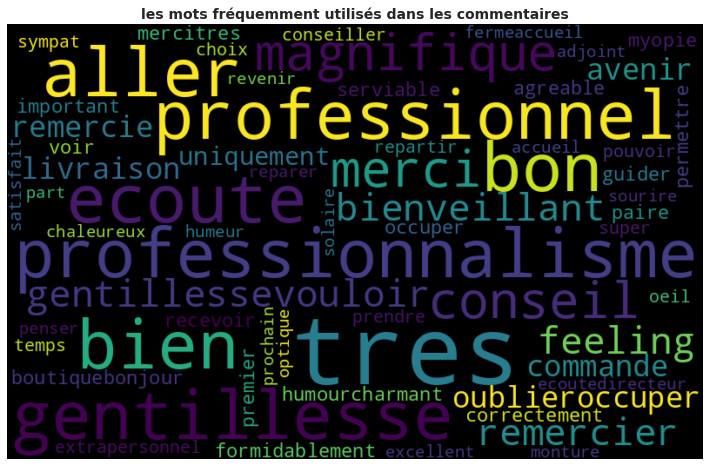

In [77]:
all_words = ''.join([word for word in df['cleaned_comments'][0:10]])
#all_words = df_plot[0]
wordcloud = WordCloud(width=800, height=500, random_state=21, max_font_size=110).generate(all_words)
plt.figure(figsize=(15,8))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis('off')
plt.title("les mots fréquemment utilisés dans les commentaires", weight='bold', fontsize=14)
plt.show()

**Topic Modeling**

In [79]:
#TF-IDF >> to remove the frequent non essentialwords 

In [80]:
# Mapping from word IDs to words
id2word = corpora.Dictionary(tokenized_docs)

In [81]:
# Prepare Document-Term Matrix
corpus = []
for doc in tokenized_docs:
    corpus.append(id2word.doc2bow(doc))

In [82]:
def compute_coherence_values(dictionary, corpus, texts, limit, start=2, step=3):
    """
    Compute c_v coherence for various number of topics

    Parameters:
    ----------
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    texts : List of input texts
    limit : Max num of topics

    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with respective number of topics
    """
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        model = gensim.models.ldamodel.LdaModel(corpus=corpus, num_topics=num_topics, id2word=id2word, random_state=42, passes=100, alpha=0.01, eta=0.9)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())
        perplexity = model.log_perplexity(corpus)

    return model_list, coherence_values

In [104]:
# Can take a long time to run.
model_list, coherence_values = compute_coherence_values(dictionary=id2word, corpus=corpus, texts=tokenized_docs, start=2, limit=40, step=6)

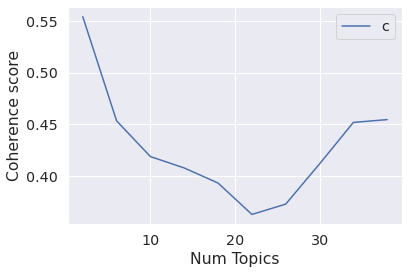

In [99]:
# Show graph
limit=40; start=2; step=4
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

In [100]:
for m, cv in zip(x, coherence_values):
    print("Num Topics =", m, " has Coherence Value of ", round(cv, 4))

Num Topics = 2  has Coherence Value of  0.5539
Num Topics = 6  has Coherence Value of  0.4533
Num Topics = 10  has Coherence Value of  0.4188
Num Topics = 14  has Coherence Value of  0.4078
Num Topics = 18  has Coherence Value of  0.3933
Num Topics = 22  has Coherence Value of  0.363
Num Topics = 26  has Coherence Value of  0.3729
Num Topics = 30  has Coherence Value of  0.4117
Num Topics = 34  has Coherence Value of  0.4518
Num Topics = 38  has Coherence Value of  0.4545


In [101]:
# Select the model and print the perplexity
optimal_model = model_list[1]
print(f"optimal model : {optimal_model}")
perplexity = optimal_model.log_perplexity(corpus)
perplexity = [1000 if perplexity < 0 else perplexity]
print("Perplexity : ", perplexity) 

optimal model : LdaModel(num_terms=2454, num_topics=6, decay=0.5, chunksize=2000)
Perplexity :  [1000]


- Coherence score and perplexity provide a convinent way to measure how good a given topic model is.
- Lower the perplexity better the model.
- Higher the topic coherence, more human interpretable the topic is. for an LDA model between 0.4 and 0.6 is acceptable

In [87]:
# Visualize with pyLDAvis: See [2] for more details
pyLDAvis.enable_notebook()
visualization = pyLDAvis.gensim_models.prepare(
    optimal_model, 
    corpus,
    id2word,
    mds = "mmds", 
    R = 30)

TypeError: drop() takes from 1 to 2 positional arguments but 3 were given

In [ ]:
visualization

NameError: name 'visualization' is not defined

In [102]:
num_topics = 6
num_words = 10

In [103]:
#display the topics and the most significant ones
model_topics = optimal_model.show_topics(formatted=False)
significant_topics = optimal_model.print_topics(num_topics=num_topics, num_words=num_words) #Get the most significant topics (alias for show_topics() method)
significant_topics.sort() 
significant_topics

[(0,
  '0.002*"glasse" + 0.002*"sunglasse" + 0.002*"terrible" + 0.001*"avoir" + 0.001*"moncler" + 0.001*"second" + 0.001*"came" + 0.001*"pm" + 0.001*"anai" + 0.001*"meilleur"'),
 (1,
  '0.053*"tres" + 0.053*"accueil" + 0.044*"bon" + 0.036*"merci" + 0.036*"service" + 0.024*"conseil" + 0.017*"recommander" + 0.015*"rapide" + 0.011*"excellent" + 0.011*"efficace"'),
 (2,
  '0.007*"cœur_rouge" + 0.002*"helpful" + 0.002*"cas" + 0.002*"recommend" + 0.002*"place" + 0.002*"prescription" + 0.001*"super" + 0.001*"glasse" + 0.001*"gout" + 0.001*"ridibitoir"'),
 (3,
  '0.029*"pas" + 0.027*"ne" + 0.021*"lunette" + 0.015*"avoir" + 0.010*"faire" + 0.010*"plus" + 0.008*"monture" + 0.008*"paire" + 0.008*"aller" + 0.008*"client"'),
 (4,
  '0.067*"tres" + 0.032*"merci" + 0.023*"lunette" + 0.022*"recommander" + 0.020*"bon" + 0.020*"bien" + 0.019*"grand" + 0.017*"accueil" + 0.016*"conseil" + 0.015*"professionnel"'),
 (5,
  '0.027*"merci" + 0.023*"lunette" + 0.012*"service" + 0.012*"reparer" + 0.012*"reparati

In [470]:
# Get the most representative words in each topic
topics = optimal_model.show_topics(num_topics=num_topics,
                               num_words=num_words,
                               formatted=False)

# Assign a name to each topic based on the most representative words
topic_names = ['Topic {}'.format(i) for i in range(num_topics)]
for i, topic in enumerate(topics):
  words = [word for word, _ in topic[1]]
  #  topic_names[i] = ' '.join(words)
  if i == 0 :
    topic_names[i] = 'catalogue produit'
  if i == 1:
     topic_names[i] = 'prise en charge'
  if i == 2:
     topic_names[i] = 'service de réparation'
  if i == 3:
     topic_names[i] = 'solaire à la vue'
  if i == 4:
     topic_names[i] = 'Accueil/professionnalisme/écoute/disponibilite'
  if i == 5:
    topic_names[i] = ' service'
  if i == 6:
    topic_names[i] = 'personnel'
  if i == 7:
     topic_names[i] = 'prise de rendez-vous'
    

# Attribute scores to each LDA topic
topic_label = []
for i, doc in enumerate(corpus):
    topic_scores = optimal_model.get_document_topics(doc)
    for topic, score in topic_scores:
        print('Document {}, {}: {}'.format(i, topic_names[topic], score))
        topic_label.append(topic_names[topic])
        topic_label.append(score)

Document 0, catalogue produit: 0.015630852431058884
Document 0, prise en charge: 0.2562723159790039
Document 0, service de réparation: 0.01564517430961132
Document 0, solaire à la vue: 0.1987520009279251
Document 0, Accueil/professionnalisme/écoute/disponibilite: 0.46677547693252563
Document 0,  service: 0.015642164275050163
Document 0, personnel: 0.0156484916806221
Document 0, prise de rendez-vous: 0.01563352905213833
Document 1, Accueil/professionnalisme/écoute/disponibilite: 0.43764597177505493
Document 1, prise de rendez-vous: 0.5122864246368408
Document 2, catalogue produit: 0.5328148007392883
Document 2, prise en charge: 0.39893993735313416
Document 2, service de réparation: 0.011367564089596272
Document 2, solaire à la vue: 0.011369578540325165
Document 2, Accueil/professionnalisme/écoute/disponibilite: 0.011370531283318996
Document 2,  service: 0.011372259818017483
Document 2, personnel: 0.01137485634535551
Document 2, prise de rendez-vous: 0.011390479281544685
Document 3, pris

In [471]:
# Rename topics

## Get the most representative words in each topic
topics = optimal_model.show_topics(num_topics=num_topics,
                               num_words=num_words,
                               formatted=False)


topic_names = ['topic {}'.format(i) for i in range(num_topics)]
for i, topic in enumerate(topics):
  words = [word for word, _ in topic[1]]
  #  topic_names[i] = ' '.join(words)
  if i == 0 :
    topic_names[i] = 'catalogue produit'
  if i == 1:
     topic_names[i] = 'prise en charge'
  if i == 2:
     topic_names[i] = 'service de réparation'
  if i == 3:
     topic_names[i] = 'solaire à la vue'
  if i == 4:
     topic_names[i] = 'Accueil/professionnalisme/écoute/disponibilite'
  if i == 5:
    topic_names[i] = ' service'
  if i == 6:
    topic_names[i] = 'personnel'
  if i == 7:
     topic_names[i] = 'prise de rendez-vous'


#Create a new dataframe with the topic name and score as columns

##Get the topic distribution for each document in the corpus
doc_topics = optimal_model.get_document_topics(corpus)


df1 = pd.DataFrame(columns=['Document'] + topic_names)
for i, doc in enumerate(doc_topics):
  row = [i] + [0] * num_topics
  for topic, score in doc:
      row[topic + 1] = score
  df1.loc[i] = row

#Rename the 'Document' column to 'Document ID'
df1 = df1.rename(columns={'Document': 'Document ID'})

# View the resulting dataframe
df1.head()

,Document ID,catalogue produit,prise en charge,service de réparation,solaire à la vue,Accueil/professionnalisme/écoute/disponibilite,service,personnel,prise de rendez-vous
0,0.0,0.015631,0.256511,0.015645,0.198713,0.466576,0.015642,0.015648,0.015634
1,1.0,0.000000,0.000000,0.000000,0.000000,0.437632,0.000000,0.000000,0.512301
2,2.0,0.532831,0.398924,0.011368,0.011370,0.011371,0.011372,0.011375,0.011391
3,3.0,0.000000,0.473927,0.000000,0.000000,0.000000,0.000000,0.000000,0.488502
4,4.0,0.012511,0.012520,0.012512,0.012543,0.012511,0.012505,0.912387,0.012511


In [472]:
#join the original df to df1
df2 = df.join(df1)

In [473]:
df2.head()

,Id,Brand_Id,Customer_Id,Date_Id#Evaluation,Site_Id,surveyType,answer,Comments,comments_length,new_comments,...,gram3_word_gt_1,Document ID,catalogue produit,prise en charge,service de réparation,solaire à la vue,Accueil/professionnalisme/écoute/disponibilite,service,personnel,prise de rendez-vous
0,1801677,1,1287839453841524983,20220922,50,Uberall - Google Review,5.0,"Très professionnel, merci à Alice pour ces mag...",15,"Très professionnel, merci à Alice pour ces mag...",...,tres_professionnel_merci,0.0,0.015631,0.256511,0.015645,0.198713,0.466576,0.015642,0.015648,0.015634
1,1801673,1,1287839453841524983,20220922,20,Uberall - Google Review,5.0,Je voulais remercier Mme Dominique pour son pr...,35,Je voulais remercier Mme Dominique pour son pr...,...,remercier_professionnalisme_gentillesse,1.0,0.000000,0.000000,0.000000,0.000000,0.437632,0.000000,0.000000,0.512301
2,1801672,1,1287839453841524983,20220922,11576,Uberall - Google Review,5.0,Antonin c'est occupé de nous de l commande à l...,32,Antonin c'est occupé de nous de l commande à l...,...,,2.0,0.532831,0.398924,0.011368,0.011370,0.011371,0.011372,0.011375,0.011391
3,1801674,1,1287839453841524983,20220922,105,Uberall - Google Review,5.0,Bonjour\nJ’ ai été reçue par Léa qui s’est for...,41,Bonjour\nJ’ ai été reçue par Léa qui s’est for...,...,,3.0,0.000000,0.473927,0.000000,0.000000,0.000000,0.000000,0.000000,0.488502
4,1801671,1,1287839453841524983,20220922,5192,Uberall - Google Review,5.0,Très bien guidé par Aurélie pour ma première p...,19,Très bien guidé par Aurélie pour ma première p...,...,tres_bien_guider,4.0,0.012511,0.012520,0.012512,0.012543,0.012511,0.012505,0.912387,0.012511


In [178]:
#topic for all docs
#df['topic'] = [max(optimal_model.get_document_topics(i), key=lambda x: x[1]) for i in corpus]
#df['topic'] = [(optimal_model.get_document_topics(i)) for i in corpus]


In [474]:
df2.columns

Index(['Id', 'Brand_Id', 'Customer_Id', 'Date_Id#Evaluation', 'Site_Id',
       'surveyType', 'answer', 'Comments', 'comments_length', 'new_comments',
       'lemmatized_docs', 'cleaned_comments', 'comments_length_2', 'gram1',
       'gram2', 'gram3', 'gram1_word_gt_1', 'gram2_word_gt_1',
       'gram3_word_gt_1', 'Document ID', 'catalogue produit',
       'prise en charge', 'service de réparation', 'solaire à la vue',
       'Accueil/professionnalisme/écoute/disponibilite', ' service',
       'personnel', 'prise de rendez-vous'],
      dtype='object')

In [475]:
#create the las table
df3= df2[['Brand_Id', 'Site_Id', 'Date_Id#Evaluation',
       'answer', 'Comments', 'comments_length',
       'gram1_word_gt_1', 'gram2_word_gt_1',
       'gram3_word_gt_1', 'catalogue produit',
       'prise en charge', 'service de réparation', 'solaire à la vue',
       'Accueil/professionnalisme/écoute/disponibilite', ' service',
       'personnel', 'prise de rendez-vous']]


In [476]:
df3[df3['Comments']== 'Top'].head()

,Brand_Id,Site_Id,Date_Id#Evaluation,answer,Comments,comments_length,gram1_word_gt_1,gram2_word_gt_1,gram3_word_gt_1,catalogue produit,prise en charge,service de réparation,solaire à la vue,Accueil/professionnalisme/écoute/disponibilite,service,personnel,prise de rendez-vous
389,1,95,20230703,5.0,Top,1,,,,0.125,0.125,0.125,0.125,0.125,0.125,0.125,0.125
516,1,6,20221210,5.0,Top,1,,,,0.125,0.125,0.125,0.125,0.125,0.125,0.125,0.125
1623,1,15,20221230,5.0,Top,1,,,,0.125,0.125,0.125,0.125,0.125,0.125,0.125,0.125


In [477]:
df3.head()

,Brand_Id,Site_Id,Date_Id#Evaluation,answer,Comments,comments_length,gram1_word_gt_1,gram2_word_gt_1,gram3_word_gt_1,catalogue produit,prise en charge,service de réparation,solaire à la vue,Accueil/professionnalisme/écoute/disponibilite,service,personnel,prise de rendez-vous
0,1,50,20220922,5.0,"Très professionnel, merci à Alice pour ces mag...",15,"tres, professionnel, merci, magnifique, consei...","tres_professionnel, professionnel_merci, merci...",tres_professionnel_merci,0.015631,0.256511,0.015645,0.198713,0.466576,0.015642,0.015648,0.015634
1,1,20,20220922,5.0,Je voulais remercier Mme Dominique pour son pr...,35,"vouloir, remercier, professionnalisme, gentill...","vouloir_remercier, remercier_professionnalisme...",remercier_professionnalisme_gentillesse,0.000000,0.000000,0.000000,0.000000,0.437632,0.000000,0.000000,0.512301
2,1,11576,20220922,5.0,Antonin c'est occupé de nous de l commande à l...,32,"occuper, commande, livraison, remercie, gentil...","occuper_commande, gentillesse_professionnalism...",,0.532831,0.398924,0.011368,0.011370,0.011371,0.011372,0.011375,0.011391
3,1,105,20220922,5.0,Bonjour\nJ’ ai été reçue par Léa qui s’est for...,41,"bonjour, recevoir, formidablement, bien, occup...","formidablement_bien, bien_occuper, voir_correc...",,0.000000,0.473927,0.000000,0.000000,0.000000,0.000000,0.000000,0.488502
4,1,5192,20220922,5.0,Très bien guidé par Aurélie pour ma première p...,19,"tres, bien, guider, premier, paire, tres, agre...","tres_bien, bien_guider, premier_paire, paire_t...",tres_bien_guider,0.012511,0.012520,0.012512,0.012543,0.012511,0.012505,0.912387,0.012511


In [481]:
df3['Comments'][4]

'Très bien guidé par Aurélie pour ma première paire de lunette. Très agréable et avec de l’humour.'

# CONNEXION A SQL SERVER : table DWH